Цель данного проекта - построить модель, способную предсказать итог футбольного матча из Европейской Лиги, основываясь на определённых характеристиках (игроков, команд и так далее). Для этой цели будет использован набор данных, взятый с сайта kaggle.

In [84]:
import pandas as pd
import sqlite3
import matplotlib.pyplot as plt
import numpy as np

Инициализируем базу данных.

In [85]:
conn = sqlite3.connect('database.sqlite')
cursor = conn.cursor()
cursor.execute("SELECT name FROM sqlite_master WHERE type='table';")
tables = cursor.fetchall()

for table in tables:
    print(table[0])

sqlite_sequence
Player_Attributes
Player
Match
League
Country
Team
Team_Attributes


Начнём анализ с таблицы match, в которой расположена информация по около двадцати шести тысячам матчей на протяжении 7 лет. Каждый матч обладает более чем сотней характеристик. Давайте разбираться и корректировать таблицу.

In [86]:
match = pd.read_sql('SELECT * FROM Match', conn)
match.head()

,id,country_id,league_id,season,stage,date,match_api_id,home_team_api_id,away_team_api_id,home_team_goal,...,SJA,VCH,VCD,VCA,GBH,GBD,GBA,BSH,BSD,BSA
0,1,1,1,2008/2009,1,2008-08-17 00:00:00,492473,9987,9993,1,...,4.00,1.65,3.40,4.50,1.78,3.25,4.00,1.73,3.40,4.20
1,2,1,1,2008/2009,1,2008-08-16 00:00:00,492474,10000,9994,0,...,3.80,2.00,3.25,3.25,1.85,3.25,3.75,1.91,3.25,3.60
2,3,1,1,2008/2009,1,2008-08-16 00:00:00,492475,9984,8635,0,...,2.50,2.35,3.25,2.65,2.50,3.20,2.50,2.30,3.20,2.75
3,4,1,1,2008/2009,1,2008-08-17 00:00:00,492476,9991,9998,5,...,7.50,1.45,3.75,6.50,1.50,3.75,5.50,1.44,3.75,6.50
4,5,1,1,2008/2009,1,2008-08-16 00:00:00,492477,7947,9985,1,...,1.73,4.50,3.40,1.65,4.50,3.50,1.65,4.75,3.30,1.67


In [87]:
match.shape

(25979, 115)

In [88]:
for col in match:
    print(col, match[f'{col}'].dtype)

id int64
country_id int64
league_id int64
season object
stage int64
date object
match_api_id int64
home_team_api_id int64
away_team_api_id int64
home_team_goal int64
away_team_goal int64
home_player_X1 float64
home_player_X2 float64
home_player_X3 float64
home_player_X4 float64
home_player_X5 float64
home_player_X6 float64
home_player_X7 float64
home_player_X8 float64
home_player_X9 float64
home_player_X10 float64
home_player_X11 float64
away_player_X1 float64
away_player_X2 float64
away_player_X3 float64
away_player_X4 float64
away_player_X5 float64
away_player_X6 float64
away_player_X7 float64
away_player_X8 float64
away_player_X9 float64
away_player_X10 float64
away_player_X11 float64
home_player_Y1 float64
home_player_Y2 float64
home_player_Y3 float64
home_player_Y4 float64
home_player_Y5 float64
home_player_Y6 float64
home_player_Y7 float64
home_player_Y8 float64
home_player_Y9 float64
home_player_Y10 float64
home_player_Y11 float64
away_player_Y1 float64
away_player_Y2 float64
aw

Первые несколько колонок отвечают за самую базовую информацию о матче (его id в системе, сезоне проведения, даты, поля). Естественно, здесь ничего трогать не нужно: это необходимая информация.

Далее следуют количество забитых голов каждой из комманд. Эти переменные (а точнее их разница) и будут спрогнозированы нашей моделью. Оставим их в обучающей выборке, но убёрем в тестовой. 

После этого идут данные о стартовом составе обеих команд: стартовая позиция игроков на поле в координатах (X, Y) и, естественно, их id для связи с другими таблицами. Это мы пока тоже оставим в модели. 

Следующими столбцами идёт информация о ходе матча (количестве фолов, угловых и так далее). Так как эти переменные известны уже после матча и не являются целевыми, то их мы уберём, ведь наша цель - предсказать исход матча, а не угадать его постфактум.

Наконец, в самом конце располагается целое море стобцов с коэффициентами разных букмекеров на тот или иной исход матча (первые две буквы переменной обозначают букмекера, а последняя - на какой исход рассчитывается этот коэффициент: H - победа home team, A - победа away team, D - draw). Все эти переменные мы так же решили убрать, так как не видим в них особой ценности, но памяти они занимают невероятно много.

In [89]:
columns_bookers = ['B365H',
                   'B365D',
                   'B365A',
                   'BWH',
                   'BWD',
                   'BWA',
                   'IWH',
                   'IWD',
                   'IWA',
                   'LBH',
                   'LBD',
                   'LBA',
                   'PSH',
                   'PSD',
                   'PSD',
                   'PSA',
                   'WHH',
                   'WHD',
                   'WHA',
                   'SJH',
                   'SJD',
                   'SJA',
                   'VCH',
                   'VCD',
                   'VCA',
                   'GBH',
                   'GBD',
                   'GBA',
                   'BSH',
                   'BSD',
                   'BSA']
match.drop(columns=columns_bookers, inplace=True)

In [90]:
columns_with_logs = ['goal',
                     'shoton',
                     'shotoff',
                     'foulcommit',
                     'card',
                     'cross',
                     'corner',
                     'possession']
match.drop(columns=columns_with_logs, inplace=True)

А ещё заменим тип данных в столбце date на правильный.

In [91]:
match['date'] = pd.to_datetime(match['date'])

In [92]:
match.shape

(25979, 77)

Уже появилось больше воздуха, но это только начало. Из оставшихся переменных наиболее неинтуитивными являются переменные, отвечающие за позиции игроков на поле. Давайте попробуем лучше их понять, нарисовав графики облак распределения.

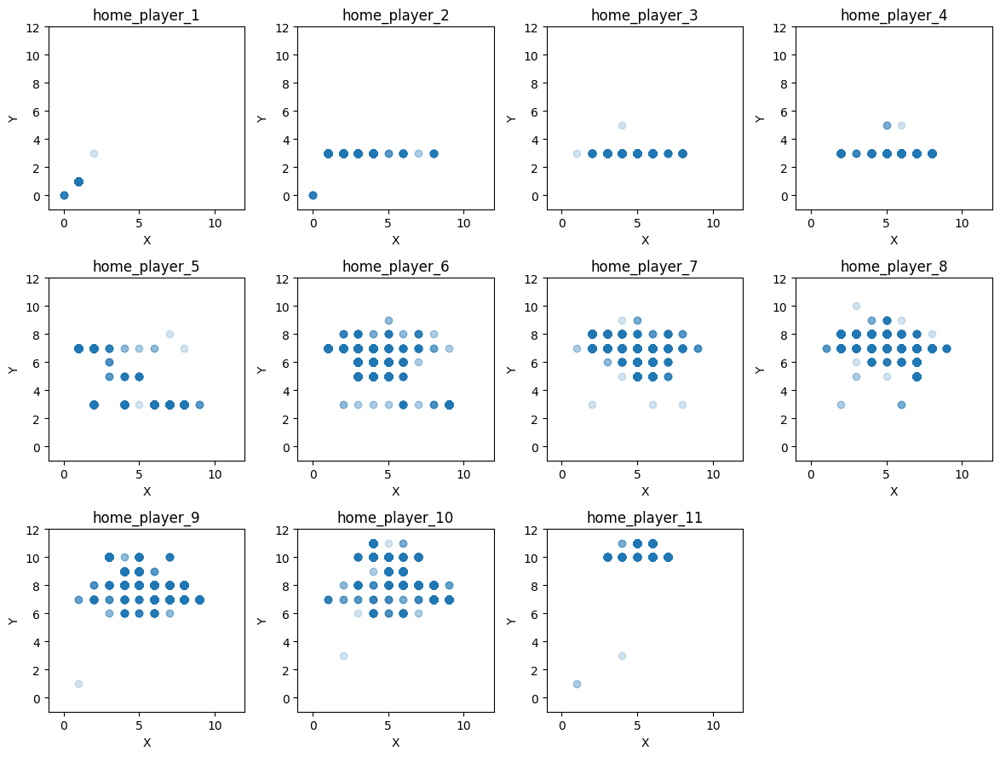

In [93]:
fig, axs = plt.subplots(3, 4, figsize=(12, 9))
axs = axs.flatten()

for i in range(1, 12):
    ax = axs[i - 1]
    ax.scatter(match[f'home_player_X{i}'], match[f'home_player_Y{i}'], alpha=0.2)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title(f'home_player_{i}')
    ax.set_xlim(-1, 12)
    ax.set_ylim(-1, 12)

plt.tight_layout()
axs[11].axis('off')
plt.show()

Теперь наглядно видно, какую позицию на поле занимает игрок. Очевидно, что чем больше Y, тем "выше" располагается игрок, то есть ближе к центру поля. Тогда вратарь будет иметь минимальное значение среди возможных: 0. Что интересно, все игроки с координатой Y = 0 имеют координату X = 0, то есть X = Y. Это важно для следующего рассуждения: помимо игроков с координатами (0; 0) встречается также большое число игроков с координатами (1; 1), причем это единственные игроки на X = 1. Логично будет предположить, что вратарям дают координаты X = Y, где Y минимальный из допустимых, просто в каких-то сезонах (или лигах) минимальный Y - это 0, а в других - это 1.

При этом, что интересно, подобная "неразбериха" с вратарями присутствует только у home_team, у away_team явно видно, что все вратари имеют координаты.

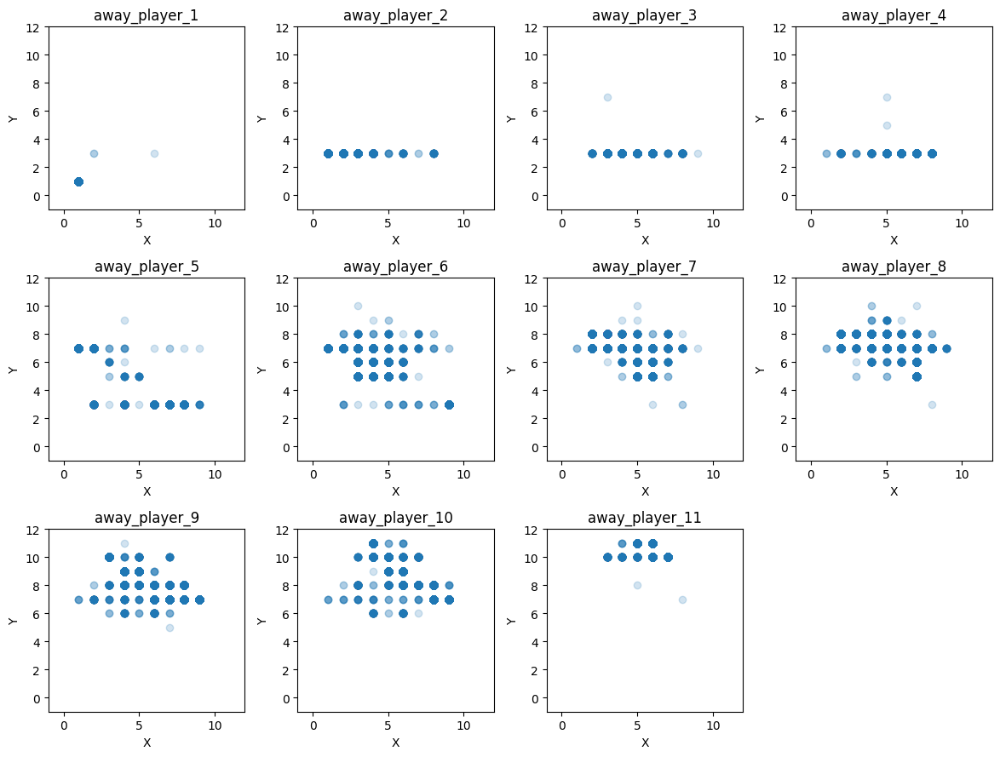

In [94]:
fig, axs = plt.subplots(3, 4, figsize=(12, 9))
axs = axs.flatten()

for i in range(1, 12):
    ax = axs[i - 1]
    ax.scatter(match[f'away_player_X{i}'], match[f'away_player_Y{i}'], alpha=0.2)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title(f'away_player_{i}')
    ax.set_xlim(-1, 12)
    ax.set_ylim(-1, 12)

plt.tight_layout()
axs[11].axis('off')
plt.show()

Однако тут сразу очевидна другая проблема: все вратари включены в away_player_1, но при этом не все away_player_1 - вратари. Получается, что в некоторых матчах гостевая команда играла без вратаря, что абсурдно.

In [95]:
for i in range(1, 12):
    print(len(match[(match[f'home_player_X{i}'] <= 1) & (match[f'home_player_Y{i}'] <= 1)]))

24157
11
0
0
0
0
0
0
1
0
2


In [96]:
print(len(match[match[f'home_player_X{1}'] > 1]))

1


Более того, вернувшись к home_player, можно обнаружить, что всего вратарей, не включенных в home_player_1 - 14, а вот не-вратарей, включенных в home_player_1, всего 1, то есть домашняя команда в некоторых мачтах, наоборот, как будто бы играла с более чем одним вратарём на поле. Давайте посмотрим на пропуски, возможно, что именно в них и кроется проблема.

In [97]:
match.isna().sum()

id                   0
country_id           0
league_id            0
season               0
stage                0
                  ... 
away_player_7     1235
away_player_8     1341
away_player_9     1328
away_player_10    1441
away_player_11    1554
Length: 77, dtype: int64

Действительно, видно, что существует большое число пропусков, причем исключительно в столбцах, отвечающих за расположение игроков. Давайте удалим их и посмотрим, что у нас останется.

In [98]:
match = match.dropna()
match.isna().sum()

id                0
country_id        0
league_id         0
season            0
stage             0
                 ..
away_player_7     0
away_player_8     0
away_player_9     0
away_player_10    0
away_player_11    0
Length: 77, dtype: int64

In [99]:
match.shape

(21361, 77)

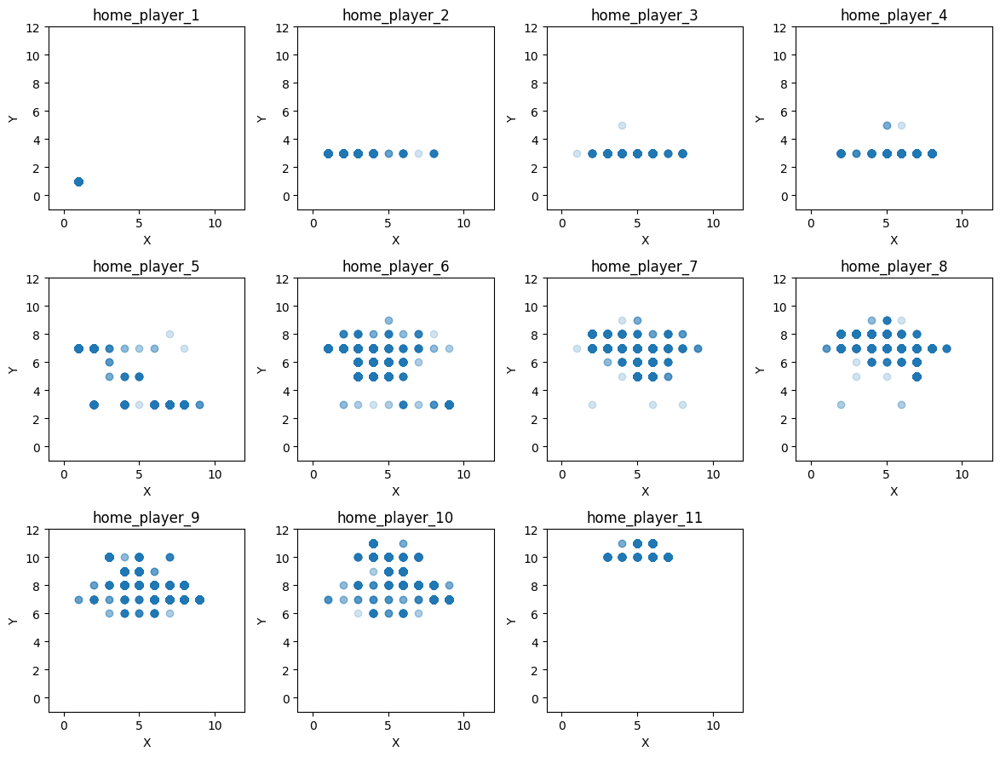

In [100]:
fig, axs = plt.subplots(3, 4, figsize=(12, 9))
axs = axs.flatten()

for i in range(1, 12):
    ax = axs[i - 1]
    ax.scatter(match[f'home_player_X{i}'], match[f'home_player_Y{i}'], alpha=0.2)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title(f'home_player_{i}')
    ax.set_xlim(-1, 12)
    ax.set_ylim(-1, 12)

plt.tight_layout()
axs[11].axis('off')
plt.show()

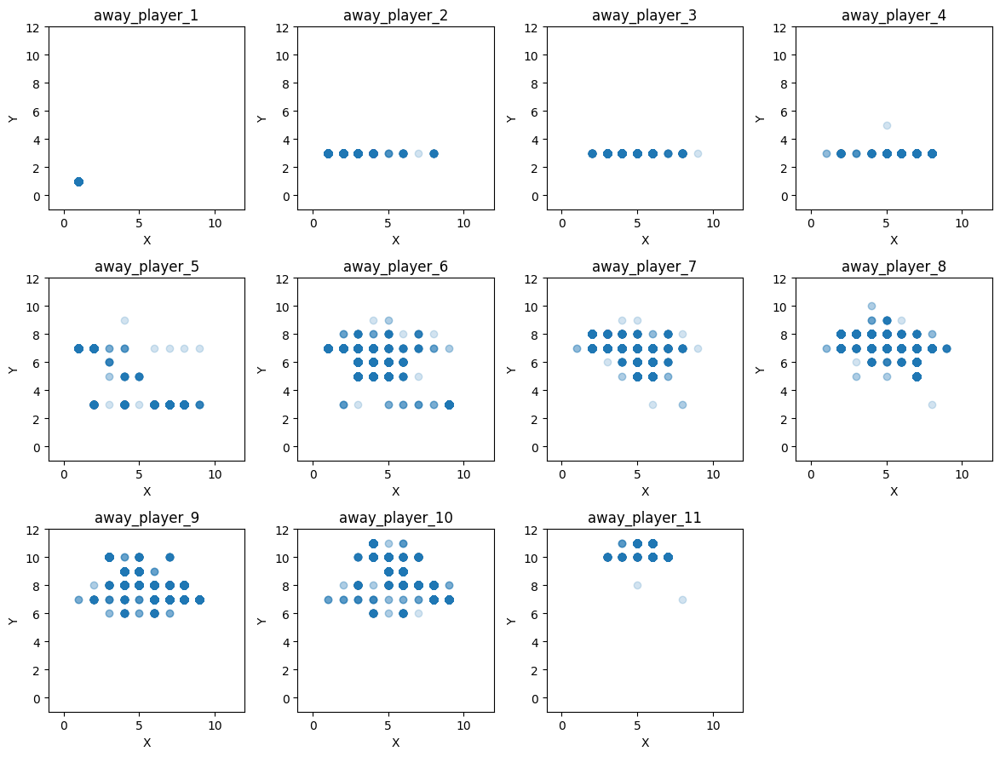

In [102]:
fig, axs = plt.subplots(3, 4, figsize=(12, 9))
axs = axs.flatten()

for i in range(1, 12):
    ax = axs[i - 1]
    ax.scatter(match[f'away_player_X{i}'], match[f'away_player_Y{i}'], alpha=0.2)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title(f'away_player_{i}')
    ax.set_xlim(-1, 12)
    ax.set_ylim(-1, 12)

plt.tight_layout()
axs[11].axis('off')
plt.show()

Теперь всё отлично: все вратари находятся исключительно в столбцах home_player_1 и away_player_1. Что интересно, в home_player пропали вратари с координатами (0; 0). 

На основе этих выводов сделаем отдельный массив с вратарями и отдельный массив с полевыми игроками

In [103]:
goalkeepers = []
home_goalkeepers = match['home_player_1'].values
away_goalkeepers = match['away_player_1'].values
goalkeepers = np.unique(np.append(np.append(home_goalkeepers, away_goalkeepers), goalkeepers))

In [104]:
fielders = []
for i in range(2, 12):
    home_fielders = match[f'home_player_{i}'].values
    away_fielders = match[f'away_player_{i}'].values
    fielders = np.unique(np.append(np.append(home_fielders, away_fielders), fielders))

А теперь пока удалим эти данные из таблицы match, так как они много весят, а как такового смысла, кроме определения вратарей и не-вратарей, не несут. Ведь позиция игроков очень редко меняется (разве что по горизонтальной оси, но нам пока не видится этот признак очень важным)

In [105]:
for i in range(1, 12):
    match.drop(columns=[f'home_player_X{i}', f'home_player_Y{i}'], inplace=True)
    match.drop(columns=[f'away_player_X{i}', f'away_player_Y{i}'], inplace=True)

In [106]:
match.head()

,id,country_id,league_id,season,stage,date,match_api_id,home_team_api_id,away_team_api_id,home_team_goal,...,away_player_2,away_player_3,away_player_4,away_player_5,away_player_6,away_player_7,away_player_8,away_player_9,away_player_10,away_player_11
145,146,1,1,2008/2009,24,2009-02-27,493017,8203,9987,2,...,38293.0,148313.0,104411.0,148314.0,37202.0,43158.0,9307.0,42153.0,32690.0,38782.0
153,154,1,1,2008/2009,25,2009-03-08,493025,9984,8342,1,...,21812.0,11736.0,37858.0,38366.0,37983.0,39578.0,38336.0,52280.0,27423.0,38440.0
155,156,1,1,2008/2009,25,2009-03-07,493027,8635,10000,2,...,37886.0,37903.0,37889.0,94030.0,37893.0,37981.0,131531.0,130027.0,38231.0,131530.0
162,163,1,1,2008/2009,26,2009-03-13,493034,8203,8635,2,...,38388.0,38389.0,31316.0,164694.0,30949.0,38378.0,38383.0,38393.0,38253.0,37069.0
168,169,1,1,2008/2009,26,2009-03-14,493040,10000,9999,0,...,38247.0,16387.0,94288.0,94284.0,45832.0,26669.0,33671.0,163670.0,37945.0,33622.0


In [107]:
match.shape

(21361, 33)

Посмотрим на таблицу под названием league.

In [108]:
league = pd.read_sql('SELECT * FROM League', conn)
league

,id,country_id,name
0,1,1,Belgium Jupiler League
1,1729,1729,England Premier League
2,4769,4769,France Ligue 1
3,7809,7809,Germany 1. Bundesliga
4,10257,10257,Italy Serie A
5,13274,13274,Netherlands Eredivisie
6,15722,15722,Poland Ekstraklasa
7,17642,17642,Portugal Liga ZON Sagres
8,19694,19694,Scotland Premier League
9,21518,21518,Spain LIGA BBVA


Она содержит только информацию о названиях лиг.

Тогда заменим столбец league_id из таблицы match соответствующим названием.

In [109]:
league.rename(columns={'id': 'league_id', 'name': 'league_name'}, inplace=True)
match = pd.merge(match, league, on='league_id', how='right')

match.drop(['league_id', 'country_id_y', 'country_id_x'], axis=1, inplace=True)

In [110]:
match.head()

,id,season,stage,date,match_api_id,home_team_api_id,away_team_api_id,home_team_goal,away_team_goal,home_player_1,...,away_player_3,away_player_4,away_player_5,away_player_6,away_player_7,away_player_8,away_player_9,away_player_10,away_player_11,league_name
0,146,2008/2009,24,2009-02-27,493017,8203,9987,2,1,38327.0,...,148313.0,104411.0,148314.0,37202.0,43158.0,9307.0,42153.0,32690.0,38782.0,Belgium Jupiler League
1,154,2008/2009,25,2009-03-08,493025,9984,8342,1,3,36835.0,...,11736.0,37858.0,38366.0,37983.0,39578.0,38336.0,52280.0,27423.0,38440.0,Belgium Jupiler League
2,156,2008/2009,25,2009-03-07,493027,8635,10000,2,0,34480.0,...,37903.0,37889.0,94030.0,37893.0,37981.0,131531.0,130027.0,38231.0,131530.0,Belgium Jupiler League
3,163,2008/2009,26,2009-03-13,493034,8203,8635,2,1,38327.0,...,38389.0,31316.0,164694.0,30949.0,38378.0,38383.0,38393.0,38253.0,37069.0,Belgium Jupiler League
4,169,2008/2009,26,2009-03-14,493040,10000,9999,0,0,37900.0,...,16387.0,94288.0,94284.0,45832.0,26669.0,33671.0,163670.0,37945.0,33622.0,Belgium Jupiler League


Теперь посмотрим на таблицу team. 

In [111]:
team = pd.read_sql('SELECT * FROM Team', conn)
team.head()

,id,team_api_id,team_fifa_api_id,team_long_name,team_short_name
0,1,9987,673.0,KRC Genk,GEN
1,2,9993,675.0,Beerschot AC,BAC
2,3,10000,15005.0,SV Zulte-Waregem,ZUL
3,4,9994,2007.0,Sporting Lokeren,LOK
4,5,9984,1750.0,KSV Cercle Brugge,CEB


В данной таблице, аналогично предыдущей, располагается только информация о названии команд. Внесём эту информацию в таблицу match.

In [112]:
team.rename(columns={'team_long_name': 'team_name'}, inplace=True)
team.drop(['team_fifa_api_id', 'id', 'team_short_name'], axis=1, inplace=True)

In [113]:
match = pd.merge(match, team, left_on='home_team_api_id', right_on='team_api_id', how='left')

In [114]:
match = pd.merge(match, team, left_on='away_team_api_id', right_on='team_api_id', how='left')

In [115]:
match.drop(['away_team_api_id', 'id', 'home_team_api_id', 'team_api_id_x', 'team_api_id_y'], axis=1, inplace=True)
match.rename(columns={'team_name_x': 'home_team_name', 'team_name_y': 'away_team_name', }, inplace=True)

In [116]:
match.insert(0, 'home_team_name', match.pop('home_team_name'))
match.insert(0, 'away_team_name', match.pop('away_team_name'))
match.insert(0, 'league_name', match.pop('league_name'))

In [117]:
match.head()

,league_name,away_team_name,home_team_name,season,stage,date,match_api_id,home_team_goal,away_team_goal,home_player_1,...,away_player_2,away_player_3,away_player_4,away_player_5,away_player_6,away_player_7,away_player_8,away_player_9,away_player_10,away_player_11
0,Belgium Jupiler League,KRC Genk,KV Mechelen,2008/2009,24,2009-02-27,493017,2,1,38327.0,...,38293.0,148313.0,104411.0,148314.0,37202.0,43158.0,9307.0,42153.0,32690.0,38782.0
1,Belgium Jupiler League,Club Brugge KV,KSV Cercle Brugge,2008/2009,25,2009-03-08,493025,1,3,36835.0,...,21812.0,11736.0,37858.0,38366.0,37983.0,39578.0,38336.0,52280.0,27423.0,38440.0
2,Belgium Jupiler League,SV Zulte-Waregem,RSC Anderlecht,2008/2009,25,2009-03-07,493027,2,0,34480.0,...,37886.0,37903.0,37889.0,94030.0,37893.0,37981.0,131531.0,130027.0,38231.0,131530.0
3,Belgium Jupiler League,RSC Anderlecht,KV Mechelen,2008/2009,26,2009-03-13,493034,2,1,38327.0,...,38388.0,38389.0,31316.0,164694.0,30949.0,38378.0,38383.0,38393.0,38253.0,37069.0
4,Belgium Jupiler League,KSV Roeselare,SV Zulte-Waregem,2008/2009,26,2009-03-14,493040,0,0,37900.0,...,38247.0,16387.0,94288.0,94284.0,45832.0,26669.0,33671.0,163670.0,37945.0,33622.0


Всё, теперь мы окончательно оформили таблицу match: никаких id (помимо собственно матчей) здесь не осталось. 

Перейдём к следующей масштабной таблице: таблице характеристик команд.

In [118]:
team_attributes = pd.read_sql('SELECT * FROM Team_Attributes', conn)
team_attributes.head()

,id,team_fifa_api_id,team_api_id,date,buildUpPlaySpeed,buildUpPlaySpeedClass,buildUpPlayDribbling,buildUpPlayDribblingClass,buildUpPlayPassing,buildUpPlayPassingClass,...,chanceCreationShooting,chanceCreationShootingClass,chanceCreationPositioningClass,defencePressure,defencePressureClass,defenceAggression,defenceAggressionClass,defenceTeamWidth,defenceTeamWidthClass,defenceDefenderLineClass
0,1,434,9930,2010-02-22 00:00:00,60,Balanced,NaN,Little,50,Mixed,...,55,Normal,Organised,50,Medium,55,Press,45,Normal,Cover
1,2,434,9930,2014-09-19 00:00:00,52,Balanced,48.0,Normal,56,Mixed,...,64,Normal,Organised,47,Medium,44,Press,54,Normal,Cover
2,3,434,9930,2015-09-10 00:00:00,47,Balanced,41.0,Normal,54,Mixed,...,64,Normal,Organised,47,Medium,44,Press,54,Normal,Cover
3,4,77,8485,2010-02-22 00:00:00,70,Fast,NaN,Little,70,Long,...,70,Lots,Organised,60,Medium,70,Double,70,Wide,Cover
4,5,77,8485,2011-02-22 00:00:00,47,Balanced,NaN,Little,52,Mixed,...,52,Normal,Organised,47,Medium,47,Press,52,Normal,Cover


In [119]:
team_attributes['date'] = pd.to_datetime(team_attributes['date'])

Опять же заменим id команд на их названия из таблицы team.

In [120]:
team_attributes = pd.merge(team_attributes, team, left_on='team_api_id', right_on='team_api_id', how='left')

In [121]:
team_attributes.drop(['team_fifa_api_id', 'id', 'team_api_id'], axis=1, inplace=True)

team_attributes.insert(0, 'team_name', team_attributes.pop('team_name'))

In [122]:
team_attributes

,team_name,date,buildUpPlaySpeed,buildUpPlaySpeedClass,buildUpPlayDribbling,buildUpPlayDribblingClass,buildUpPlayPassing,buildUpPlayPassingClass,buildUpPlayPositioningClass,chanceCreationPassing,...,chanceCreationShooting,chanceCreationShootingClass,chanceCreationPositioningClass,defencePressure,defencePressureClass,defenceAggression,defenceAggressionClass,defenceTeamWidth,defenceTeamWidthClass,defenceDefenderLineClass
0,FC Aarau,2010-02-22,60,Balanced,NaN,Little,50,Mixed,Organised,60,...,55,Normal,Organised,50,Medium,55,Press,45,Normal,Cover
1,FC Aarau,2014-09-19,52,Balanced,48.0,Normal,56,Mixed,Organised,54,...,64,Normal,Organised,47,Medium,44,Press,54,Normal,Cover
2,FC Aarau,2015-09-10,47,Balanced,41.0,Normal,54,Mixed,Organised,54,...,64,Normal,Organised,47,Medium,44,Press,54,Normal,Cover
3,Aberdeen,2010-02-22,70,Fast,NaN,Little,70,Long,Organised,70,...,70,Lots,Organised,60,Medium,70,Double,70,Wide,Cover
4,Aberdeen,2011-02-22,47,Balanced,NaN,Little,52,Mixed,Organised,53,...,52,Normal,Organised,47,Medium,47,Press,52,Normal,Cover
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1453,SV Zulte-Waregem,2011-02-22,52,Balanced,NaN,Little,52,Mixed,Organised,52,...,53,Normal,Organised,46,Medium,48,Press,53,Normal,Cover
1454,SV Zulte-Waregem,2012-02-22,54,Balanced,NaN,Little,51,Mixed,Organised,47,...,50,Normal,Organised,44,Medium,55,Press,53,Normal,Cover
1455,SV Zulte-Waregem,2013-09-20,54,Balanced,NaN,Little,51,Mixed,Organised,47,...,32,Little,Organised,44,Medium,58,Press,37,Normal,Cover
1456,SV Zulte-Waregem,2014-09-19,54,Balanced,42.0,Normal,51,Mixed,Organised,47,...,32,Little,Organised,44,Medium,58,Press,37,Normal,Cover


In [123]:
for col in team_attributes:
    print(col, team_attributes[f'{col}'].dtype)

team_name object
date datetime64[ns]
buildUpPlaySpeed int64
buildUpPlaySpeedClass object
buildUpPlayDribbling float64
buildUpPlayDribblingClass object
buildUpPlayPassing int64
buildUpPlayPassingClass object
buildUpPlayPositioningClass object
chanceCreationPassing int64
chanceCreationPassingClass object
chanceCreationCrossing int64
chanceCreationCrossingClass object
chanceCreationShooting int64
chanceCreationShootingClass object
chanceCreationPositioningClass object
defencePressure int64
defencePressureClass object
defenceAggression int64
defenceAggressionClass object
defenceTeamWidth int64
defenceTeamWidthClass object
defenceDefenderLineClass object


Давайте я вам расскажу, за что отвечает каждая колонка в этой таблице. Сразу стоит напомнить, что рейтинги команд периодически обновляются, поэтому нет ничего удвительного в том, что одна и та же команда встречается несколько раз. Если вкратце, характеристики, начинающиеся с buildUp, отвечают за сыгранность команды. chanceCreation в первую очередь отвечает за создание атакающих моментов в игре, благодаря повышению вероятности точных передач, граммотного позиционирования и так далее. Наконец, как не сложно догадаться, параметры, начинающиеся с defence, характеризуют эффективность и тактику обороны команды, например, степень прессинга во время обороны или глубину оборонительной линии.

Значения в столбцах, оканчивающихся на Class, напрямую зависят от числа в предшествующем им столбце с тем же названием, но без приписки Class. Иными словами, класс команды по той или иной характеристике зависит от того, в какой интервал попадает значение этой характеристики. Соответственно, оставлять оба столбца (с Class и без) не имеет никакого смысла, ведь они напрямую коррелируют друг с другом и вообще отвечают за один и тот же параметр команды. На данный момент мы пришли к выводу, что лучше удалить все столбцы с Class, оставив стобцы с числами, для более точного обучения модели, однако мы не исключаем, что модель может переобучиться, и тогда мы вернемся именно к Class-столбцам.

In [124]:
team_attributes['buildUpPlaySpeedClass'].value_counts()

buildUpPlaySpeedClass
Balanced    1184
Fast         172
Slow         102
Name: count, dtype: int64

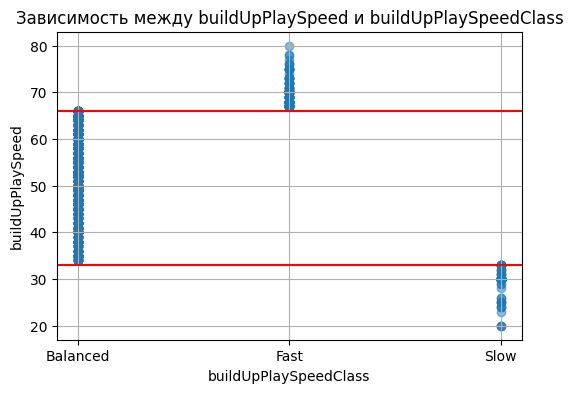

In [125]:
plt.figure(figsize=(6, 4))
plt.scatter(team_attributes['buildUpPlaySpeedClass'], team_attributes['buildUpPlaySpeed'],
            alpha=0.5)
plt.axhline(y=team_attributes[team_attributes['buildUpPlaySpeedClass'] == 'Balanced']['buildUpPlaySpeed'].max()
            , color='red')
plt.axhline(y=team_attributes[team_attributes['buildUpPlaySpeedClass'] == 'Slow']['buildUpPlaySpeed'].max()
            , color='red')
plt.title('Зависимость между buildUpPlaySpeed и buildUpPlaySpeedClass')
plt.xlabel('buildUpPlaySpeedClass')
plt.ylabel('buildUpPlaySpeed')
plt.grid(True) 
plt.show()

Удалим все переменные, которые кончаются на Class, а в остальном повторяют название вышестоящей переменной. Это важное уточнение, так как переменные buildUpPlayPositioningClass, chanceCreationPositioningClass, defenceDefenderLineClass "берут" свои значения не из соответствующей им целочисленной переменной, а являются сугубо категориальными. Начнём с удаления buildUp столбцов

In [126]:
team_attributes.drop(['buildUpPlaySpeedClass', 'buildUpPlayDribblingClass', 'buildUpPlayPassingClass'], axis=1, inplace=True)

Как было сказано выше, cледующий признак, buildUpPlayPositioningClass, встречается только в виде категориальной переменной, а потому убрать его мы себе позволить не можем.

In [127]:
team_attributes['buildUpPlayPositioningClass'].value_counts()

buildUpPlayPositioningClass
Organised    1386
Free Form      72
Name: count, dtype: int64

Более того, он принимает всего два значения: Organised и Free Form. С помощью OHE-Кодинга оставим только признак buildUpPlayPositioning_Organised.

In [128]:
team_attributes_encoded = pd.get_dummies(team_attributes['buildUpPlayPositioningClass'],
                                         prefix='buildUpPlayPositioning')

team_attributes = pd.concat([team_attributes, team_attributes_encoded], axis=1)

team_attributes.drop(['buildUpPlayPositioningClass', 'buildUpPlayPositioning_Free Form'], axis=1, inplace=True)

Настал черёд столбцов chanceCreation.

In [129]:
team_attributes.drop(['chanceCreationPassingClass', 'chanceCreationCrossingClass', 'chanceCreationShootingClass'], axis=1, inplace=True)

Опять подкорректируем сугубо категориальную переменную chanceCreationPositioningClass с помощью OHE-кодинга.

In [130]:
team_attributes['chanceCreationPositioningClass'].value_counts()

chanceCreationPositioningClass
Organised    1309
Free Form     149
Name: count, dtype: int64

In [131]:
team_attributes_encoded = pd.get_dummies(team_attributes['chanceCreationPositioningClass'],
                                         prefix='chanceCreationPositioning')

team_attributes = pd.concat([team_attributes, team_attributes_encoded], axis=1)

team_attributes.drop(['chanceCreationPositioningClass', 'chanceCreationPositioning_Free Form'], axis=1, inplace=True)

Переходим к defence...

In [133]:
team_attributes.drop(['defencePressureClass', 'defenceAggressionClass', 'defenceTeamWidthClass'], axis=1, inplace=True)

И исправим последнюю переменную с помощью OHE-кодинга.

In [134]:
team_attributes['defenceDefenderLineClass'].value_counts()

defenceDefenderLineClass
Cover           1362
Offside Trap      96
Name: count, dtype: int64

In [135]:
team_attributes_encoded = pd.get_dummies(team_attributes['defenceDefenderLineClass'],
                                         prefix='defenceDefenderLine')

team_attributes = pd.concat([team_attributes, team_attributes_encoded], axis=1)

team_attributes.drop(['defenceDefenderLineClass', 'defenceDefenderLine_Offside Trap'], axis=1, inplace=True)

Теперь проверим, есть ли в данных какие-то пропуски.

In [136]:
team_attributes.isna().sum()

team_name                                0
date                                     0
buildUpPlaySpeed                         0
buildUpPlayDribbling                   969
buildUpPlayPassing                       0
chanceCreationPassing                    0
chanceCreationCrossing                   0
chanceCreationShooting                   0
defencePressure                          0
defenceAggression                        0
defenceTeamWidth                         0
buildUpPlayPositioning_Organised         0
chanceCreationPositioning_Organised      0
defenceDefenderLine_Cover                0
dtype: int64

In [137]:
team_attributes.shape

(1458, 14)

Действительно, пропуски были обнаружены, и причем очень много: 969 пропусков из 1458 значений. Хорошо, что эти пропуски встречаются лишь по одной переменной, buildUpPlayDribbling. Скорее всего это связано с тем, что её добавили в одной из последних версий фифы. Мы думаем, что можно спокойно удалить этот параметр, не навредив нашей модели.

In [138]:
team_attributes.drop('buildUpPlayDribbling', axis=1, inplace=True)

In [139]:
team_attributes.isna().sum()

team_name                              0
date                                   0
buildUpPlaySpeed                       0
buildUpPlayPassing                     0
chanceCreationPassing                  0
chanceCreationCrossing                 0
chanceCreationShooting                 0
defencePressure                        0
defenceAggression                      0
defenceTeamWidth                       0
buildUpPlayPositioning_Organised       0
chanceCreationPositioning_Organised    0
defenceDefenderLine_Cover              0
dtype: int64

In [140]:
team_attributes

,team_name,date,buildUpPlaySpeed,buildUpPlayPassing,chanceCreationPassing,chanceCreationCrossing,chanceCreationShooting,defencePressure,defenceAggression,defenceTeamWidth,buildUpPlayPositioning_Organised,chanceCreationPositioning_Organised,defenceDefenderLine_Cover
0,FC Aarau,2010-02-22,60,50,60,65,55,50,55,45,True,True,True
1,FC Aarau,2014-09-19,52,56,54,63,64,47,44,54,True,True,True
2,FC Aarau,2015-09-10,47,54,54,63,64,47,44,54,True,True,True
3,Aberdeen,2010-02-22,70,70,70,70,70,60,70,70,True,True,True
4,Aberdeen,2011-02-22,47,52,53,48,52,47,47,52,True,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1453,SV Zulte-Waregem,2011-02-22,52,52,52,48,53,46,48,53,True,True,True
1454,SV Zulte-Waregem,2012-02-22,54,51,47,52,50,44,55,53,True,True,True
1455,SV Zulte-Waregem,2013-09-20,54,51,47,52,32,44,58,37,True,True,True
1456,SV Zulte-Waregem,2014-09-19,54,51,47,52,32,44,58,37,True,True,True


теперь игроки


выяснилось, что не все игроки участвовавшие в матчах есть в player_attributes

In [171]:
player_attributes = pd.read_sql('SELECT * FROM Player_Attributes', conn)
player_attributes.head()

,id,player_fifa_api_id,player_api_id,date,overall_rating,potential,preferred_foot,attacking_work_rate,defensive_work_rate,crossing,...,vision,penalties,marking,standing_tackle,sliding_tackle,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes
0,1,218353,505942,2016-02-18 00:00:00,67.0,71.0,right,medium,medium,49.0,...,54.0,48.0,65.0,69.0,69.0,6.0,11.0,10.0,8.0,8.0
1,2,218353,505942,2015-11-19 00:00:00,67.0,71.0,right,medium,medium,49.0,...,54.0,48.0,65.0,69.0,69.0,6.0,11.0,10.0,8.0,8.0
2,3,218353,505942,2015-09-21 00:00:00,62.0,66.0,right,medium,medium,49.0,...,54.0,48.0,65.0,66.0,69.0,6.0,11.0,10.0,8.0,8.0
3,4,218353,505942,2015-03-20 00:00:00,61.0,65.0,right,medium,medium,48.0,...,53.0,47.0,62.0,63.0,66.0,5.0,10.0,9.0,7.0,7.0
4,5,218353,505942,2007-02-22 00:00:00,61.0,65.0,right,medium,medium,48.0,...,53.0,47.0,62.0,63.0,66.0,5.0,10.0,9.0,7.0,7.0


In [241]:
players_in_realdata = []
for i in range(1, 12):
    players_in_realdata = np.unique(np.append(
        np.append(
            np.unique((match[f'home_player_{i}'])), np.unique((match[f'away_player_{i}']))),
        players_in_realdata))
np.setdiff1d(players_in_realdata, player_attributes['player_api_id'])

array([359194.])

видим, что есть один футболист которого нет почему то в player_attributes, придется дропнуть все матчи с ним

In [245]:
for i in range(1, 12):
    match = match[(match[f'home_player_{i}'] != 359194.0) | (match[f'away_player_{i}'] != 359194.0)]

In [172]:
player_attributes['date'] = pd.to_datetime(player_attributes['date'])

In [173]:
player_attributes.drop(['player_fifa_api_id', 'id'], axis=1, inplace=True)

In [174]:
player_attributes.isna().sum()

player_api_id             0
date                      0
overall_rating          836
potential               836
preferred_foot          836
attacking_work_rate    3230
defensive_work_rate     836
crossing                836
finishing               836
heading_accuracy        836
short_passing           836
volleys                2713
dribbling               836
curve                  2713
free_kick_accuracy      836
long_passing            836
ball_control            836
acceleration            836
sprint_speed            836
agility                2713
reactions               836
balance                2713
shot_power              836
jumping                2713
stamina                 836
strength                836
long_shots              836
aggression              836
interceptions           836
positioning             836
vision                 2713
penalties               836
marking                 836
standing_tackle         836
sliding_tackle         2713
gk_diving           

опять заменим индексы на имена

In [175]:
player = pd.read_sql('SELECT * FROM Player', conn)
player.head()

,id,player_api_id,player_name,player_fifa_api_id,birthday,height,weight
0,1,505942,Aaron Appindangoye,218353,1992-02-29 00:00:00,182.88,187
1,2,155782,Aaron Cresswell,189615,1989-12-15 00:00:00,170.18,146
2,3,162549,Aaron Doran,186170,1991-05-13 00:00:00,170.18,163
3,4,30572,Aaron Galindo,140161,1982-05-08 00:00:00,182.88,198
4,5,23780,Aaron Hughes,17725,1979-11-08 00:00:00,182.88,154


In [176]:
player['birthday'] = pd.to_datetime(player['birthday'])

In [177]:
player.drop(['player_fifa_api_id', 'id'], axis=1, inplace=True)

In [178]:
player_attributes = pd.merge(player_attributes, player, left_on='player_api_id', right_on='player_api_id', how='left')

сделаем вместо даты рожденяи возраст на момент замера информации об игроке

In [179]:
player_attributes['age'] = (player_attributes['date'] - player_attributes['birthday']).astype('<m8[Y]')
player_attributes.drop('birthday', axis=1, inplace=True)

In [180]:
player_attributes.insert(0, 'age', player_attributes.pop('age'))
player_attributes.insert(0, 'weight', player_attributes.pop('weight'))
player_attributes.insert(0, 'height', player_attributes.pop('height'))
player_attributes.insert(0, 'player_name', player_attributes.pop('player_name'))

In [181]:
player_attributes

,player_name,height,weight,age,player_api_id,date,overall_rating,potential,preferred_foot,attacking_work_rate,...,vision,penalties,marking,standing_tackle,sliding_tackle,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes
0,Aaron Appindangoye,182.88,187,23.0,505942,2016-02-18,67.0,71.0,right,medium,...,54.0,48.0,65.0,69.0,69.0,6.0,11.0,10.0,8.0,8.0
1,Aaron Appindangoye,182.88,187,23.0,505942,2015-11-19,67.0,71.0,right,medium,...,54.0,48.0,65.0,69.0,69.0,6.0,11.0,10.0,8.0,8.0
2,Aaron Appindangoye,182.88,187,23.0,505942,2015-09-21,62.0,66.0,right,medium,...,54.0,48.0,65.0,66.0,69.0,6.0,11.0,10.0,8.0,8.0
3,Aaron Appindangoye,182.88,187,23.0,505942,2015-03-20,61.0,65.0,right,medium,...,53.0,47.0,62.0,63.0,66.0,5.0,10.0,9.0,7.0,7.0
4,Aaron Appindangoye,182.88,187,14.0,505942,2007-02-22,61.0,65.0,right,medium,...,53.0,47.0,62.0,63.0,66.0,5.0,10.0,9.0,7.0,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183973,Zvjezdan Misimovic,180.34,176,27.0,39902,2009-08-30,83.0,85.0,right,medium,...,88.0,83.0,22.0,31.0,30.0,9.0,20.0,84.0,20.0,20.0
183974,Zvjezdan Misimovic,180.34,176,26.0,39902,2009-02-22,78.0,80.0,right,medium,...,88.0,70.0,32.0,31.0,30.0,9.0,20.0,73.0,20.0,20.0
183975,Zvjezdan Misimovic,180.34,176,26.0,39902,2008-08-30,77.0,80.0,right,medium,...,88.0,70.0,32.0,31.0,30.0,9.0,20.0,73.0,20.0,20.0
183976,Zvjezdan Misimovic,180.34,176,25.0,39902,2007-08-30,78.0,81.0,right,medium,...,88.0,53.0,28.0,32.0,30.0,9.0,20.0,73.0,20.0,20.0


видим, что после 08го года пропущенных значений много меньше, так что далее просто ограничим наше исследование сезонами с 08/09 по 15/16

In [182]:
player_attributes.loc[player_attributes['date'] > '2008-07-01'].isna().sum()

player_name               0
height                    0
weight                    0
age                       0
player_api_id             0
date                      0
overall_rating          100
potential               100
preferred_foot          100
attacking_work_rate    1596
defensive_work_rate     100
crossing                100
finishing               100
heading_accuracy        100
short_passing           100
volleys                1159
dribbling               100
curve                  1159
free_kick_accuracy      100
long_passing            100
ball_control            100
acceleration            100
sprint_speed            100
agility                1159
reactions               100
balance                1159
shot_power              100
jumping                1159
stamina                 100
strength                100
long_shots              100
aggression              100
interceptions           100
positioning             100
vision                 1159
penalties           

In [183]:
player_attributes = player_attributes.loc[player_attributes['date'] > '2008-07-01'].copy()
match = match.loc[match['date'] > '2009-07-01'].copy()

как будто potential можно дропнуть

In [184]:
player_attributes.drop('potential', axis=1, inplace=True)

делаем OHE для ноги

In [185]:
player_attributes['preferred_foot'].value_counts()

right    126276
left      41055
Name: preferred_foot, dtype: int64

In [186]:
player_attributes_encoded = pd.get_dummies(player_attributes['preferred_foot'],
                                           prefix='preferred_foot')

player_attributes = pd.concat([player_attributes, player_attributes_encoded], axis=1)

player_attributes.drop(['preferred_foot', 'preferred_foot_left'], axis=1, inplace=True)

смотрим на attacking_work_rate

In [187]:
player_attributes['attacking_work_rate'].value_counts()

medium    114352
high       40331
low         7828
None        2884
norm         234
y             74
le            69
stoc          63
Name: attacking_work_rate, dtype: int64

Тут нужно кодиком АНдрюхи показать, что для адекватных значений эта штука полностью коррелирует с обычным атакрейтом и дропнуть , с дефенсрейтом тожсамое

In [188]:
player_attributes['pace'] = 0.55 * player_attributes['sprint_speed'] + 0.45 * player_attributes['acceleration']
player_attributes['shooting'] = 0.45 * player_attributes['finishing'] + 0.2 * player_attributes['long_shots'] + 0.2 * \
                                player_attributes['shot_power'] + 0.05 * player_attributes[
                                    'positioning'] + 0.05 * player_attributes['penalties'] + 0.05 * player_attributes[
                                    'volleys']
player_attributes['passing'] = 0.35 * player_attributes['short_passing'] + 0.2 * player_attributes['vision'] + 0.2 * \
                               player_attributes['crossing'] + 0.15 * player_attributes[
                                   'long_passing'] + 0.05 * player_attributes['curve'] + 0.05 * player_attributes[
                                   'free_kick_accuracy']
player_attributes['dribbling'] = 0.5 * player_attributes['dribbling'] + 0.35 * player_attributes['ball_control'] + 0.1 * \
                                 player_attributes['agility'] + 0.05 * player_attributes['balance']
player_attributes['defending'] = 0.3 * player_attributes['marking'] + 0.3 * player_attributes['standing_tackle'] + 0.2 * \
                                 player_attributes['interceptions'] + 0.1 * player_attributes[
                                     'heading_accuracy'] + 0.1 * player_attributes['sliding_tackle']
player_attributes['physical'] = 0.5 * player_attributes['strength'] + 0.25 * player_attributes['stamina'] + 0.25 * \
                                player_attributes['aggression'] + 0.05 * player_attributes['jumping']

In [189]:
# player_attributes.drop('attacking_work_rate', axis=1, inplace=True)

тож самое с defensive_work_rate, только тут как будто бы есть какие то данные выбивающиеся из основной массы, но нам их трудно интерпретирвоать и они находятся в подавляющем меньшинстве (еть варик сделать 0-3 -low, 4-7 - medium и тд, зодумайтесь)

в конце концов дропнул

In [190]:
# player_attributes.drop('defensive_work_rate', axis=1, inplace=True)

In [191]:
player_attributes

,player_name,height,weight,age,player_api_id,date,overall_rating,attacking_work_rate,defensive_work_rate,crossing,...,gk_handling,gk_kicking,gk_positioning,gk_reflexes,preferred_foot_right,pace,shooting,passing,defending,physical
0,Aaron Appindangoye,182.88,187,23.0,505942,2016-02-18,67.0,medium,medium,49.0,...,11.0,10.0,8.0,8.0,1,62.20,44.65,55.75,68.2,72.15
1,Aaron Appindangoye,182.88,187,23.0,505942,2015-11-19,67.0,medium,medium,49.0,...,11.0,10.0,8.0,8.0,1,62.20,44.65,55.75,68.2,72.15
2,Aaron Appindangoye,182.88,187,23.0,505942,2015-09-21,62.0,medium,medium,49.0,...,11.0,10.0,8.0,8.0,1,62.20,44.65,55.75,61.5,70.15
3,Aaron Appindangoye,182.88,187,23.0,505942,2015-03-20,61.0,medium,medium,48.0,...,10.0,9.0,7.0,7.0,1,62.20,43.65,54.75,59.1,69.90
5,Aaron Cresswell,170.18,146,26.0,155782,2016-04-21,74.0,high,medium,80.0,...,7.0,9.0,9.0,12.0,0,78.45,58.40,71.20,72.3,69.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183971,Zvjezdan Misimovic,180.34,176,28.0,39902,2011-02-22,81.0,medium,low,81.0,...,13.0,8.0,15.0,5.0,1,67.20,79.00,83.95,31.2,69.65
183972,Zvjezdan Misimovic,180.34,176,28.0,39902,2010-08-30,83.0,medium,low,84.0,...,13.0,8.0,15.0,5.0,1,67.20,79.00,85.65,31.2,69.65
183973,Zvjezdan Misimovic,180.34,176,27.0,39902,2009-08-30,83.0,medium,low,84.0,...,20.0,84.0,20.0,20.0,1,69.30,78.35,86.35,40.4,68.40
183974,Zvjezdan Misimovic,180.34,176,26.0,39902,2009-02-22,78.0,medium,low,74.0,...,20.0,73.0,20.0,20.0,1,66.55,74.75,80.75,40.0,67.15


больше катгориальных нет, остается только кодиком андрюхи все это к божескому виду привести и объеденить все колонки, Эндрю, на тебе задача объяснить что эти формулы релевантны и имеют смысол

теперь сделаем фреймы с атрибутами вратарей и полевых

In [192]:
gk_attributes = player_attributes[player_attributes['player_api_id'].isin(goalkeepers)].copy()

In [193]:
fl_attributes = player_attributes[player_attributes['player_api_id'].isin(fielders)].copy()

In [194]:
fl_attributes

,player_name,height,weight,age,player_api_id,date,overall_rating,attacking_work_rate,defensive_work_rate,crossing,...,gk_handling,gk_kicking,gk_positioning,gk_reflexes,preferred_foot_right,pace,shooting,passing,defending,physical
0,Aaron Appindangoye,182.88,187,23.0,505942,2016-02-18,67.0,medium,medium,49.0,...,11.0,10.0,8.0,8.0,1,62.20,44.65,55.75,68.2,72.15
1,Aaron Appindangoye,182.88,187,23.0,505942,2015-11-19,67.0,medium,medium,49.0,...,11.0,10.0,8.0,8.0,1,62.20,44.65,55.75,68.2,72.15
2,Aaron Appindangoye,182.88,187,23.0,505942,2015-09-21,62.0,medium,medium,49.0,...,11.0,10.0,8.0,8.0,1,62.20,44.65,55.75,61.5,70.15
3,Aaron Appindangoye,182.88,187,23.0,505942,2015-03-20,61.0,medium,medium,48.0,...,10.0,9.0,7.0,7.0,1,62.20,43.65,54.75,59.1,69.90
5,Aaron Cresswell,170.18,146,26.0,155782,2016-04-21,74.0,high,medium,80.0,...,7.0,9.0,9.0,12.0,0,78.45,58.40,71.20,72.3,69.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183971,Zvjezdan Misimovic,180.34,176,28.0,39902,2011-02-22,81.0,medium,low,81.0,...,13.0,8.0,15.0,5.0,1,67.20,79.00,83.95,31.2,69.65
183972,Zvjezdan Misimovic,180.34,176,28.0,39902,2010-08-30,83.0,medium,low,84.0,...,13.0,8.0,15.0,5.0,1,67.20,79.00,85.65,31.2,69.65
183973,Zvjezdan Misimovic,180.34,176,27.0,39902,2009-08-30,83.0,medium,low,84.0,...,20.0,84.0,20.0,20.0,1,69.30,78.35,86.35,40.4,68.40
183974,Zvjezdan Misimovic,180.34,176,26.0,39902,2009-02-22,78.0,medium,low,74.0,...,20.0,73.0,20.0,20.0,1,66.55,74.75,80.75,40.0,67.15


In [195]:
gk_attributes

,player_name,height,weight,age,player_api_id,date,overall_rating,attacking_work_rate,defensive_work_rate,crossing,...,gk_handling,gk_kicking,gk_positioning,gk_reflexes,preferred_foot_right,pace,shooting,passing,defending,physical
172,Aaron Lennox,190.50,181,23.0,528212,2016-02-25,48.0,medium,medium,12.0,...,41.0,39.0,51.0,53.0,1,21.05,17.80,17.75,15.6,33.65
173,Aaron Lennox,190.50,181,22.0,528212,2016-01-28,48.0,medium,medium,12.0,...,41.0,39.0,51.0,53.0,1,21.05,17.80,17.75,15.6,33.65
174,Aaron Lennox,190.50,181,21.0,528212,2014-12-27,48.0,medium,medium,12.0,...,41.0,39.0,51.0,53.0,1,21.05,17.80,17.75,15.6,33.65
175,Aaron Lennox,190.50,181,21.0,528212,2014-10-31,48.0,medium,medium,12.0,...,41.0,39.0,51.0,53.0,1,21.05,17.80,17.75,15.6,33.65
176,Aaron Lennox,190.50,181,21.0,528212,2014-10-10,48.0,medium,medium,12.0,...,41.0,39.0,51.0,53.0,1,21.05,17.80,17.75,15.6,33.65
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183531,Zeljko Brkic,198.12,209,26.0,157284,2013-02-15,78.0,medium,medium,12.0,...,74.0,55.0,82.0,80.0,1,54.45,18.10,26.55,15.4,63.65
183532,Zeljko Brkic,198.12,209,26.0,157284,2012-08-31,76.0,medium,medium,12.0,...,76.0,51.0,78.0,78.0,1,54.45,18.10,26.55,15.4,63.65
183533,Zeljko Brkic,198.12,209,25.0,157284,2011-08-30,71.0,medium,medium,12.0,...,72.0,73.0,64.0,78.0,1,59.40,20.25,27.00,12.7,70.75
183535,Zeljko Kalac,203.20,209,36.0,30850,2009-02-22,73.0,None,o,20.0,...,73.0,71.0,73.0,75.0,1,44.30,NaN,NaN,NaN,NaN


как то надо придумать какие параметры важны для голкиперов, очевидно не только те чт с пометкой gk

In [196]:
columns_gk = ['player_name', 'height', 'weight', 'age', 'player_api_id', 'date', 'overall_rating', 'sprint_speed',
              'gk_diving', 'gk_handling', 'gk_kicking', 'gk_positioning', 'gk_reflexes']
gk_attributes.drop(gk_attributes.columns.difference(columns_gk), axis=1, inplace=True)

In [197]:
columns_fl = ['player_name', 'height', 'weight', 'age', 'player_api_id', 'date', 'overall_rating', 'pace',
              'shooting', 'passing', 'dribbling', 'defending', 'physical', 'preferred_foot_right']
fl_attributes.drop(fl_attributes.columns.difference(columns_fl), axis=1, inplace=True)

In [198]:
fl_attributes

,player_name,height,weight,age,player_api_id,date,overall_rating,dribbling,preferred_foot_right,pace,shooting,passing,defending,physical
0,Aaron Appindangoye,182.88,187,23.0,505942,2016-02-18,67.0,51.80,1,62.20,44.65,55.75,68.2,72.15
1,Aaron Appindangoye,182.88,187,23.0,505942,2015-11-19,67.0,51.80,1,62.20,44.65,55.75,68.2,72.15
2,Aaron Appindangoye,182.88,187,23.0,505942,2015-09-21,62.0,51.80,1,62.20,44.65,55.75,61.5,70.15
3,Aaron Appindangoye,182.88,187,23.0,505942,2015-03-20,61.0,50.95,1,62.20,43.65,54.75,59.1,69.90
5,Aaron Cresswell,170.18,146,26.0,155782,2016-04-21,74.0,73.65,0,78.45,58.40,71.20,72.3,69.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183971,Zvjezdan Misimovic,180.34,176,28.0,39902,2011-02-22,81.0,80.75,1,67.20,79.00,83.95,31.2,69.65
183972,Zvjezdan Misimovic,180.34,176,28.0,39902,2010-08-30,83.0,83.10,1,67.20,79.00,85.65,31.2,69.65
183973,Zvjezdan Misimovic,180.34,176,27.0,39902,2009-08-30,83.0,83.10,1,69.30,78.35,86.35,40.4,68.40
183974,Zvjezdan Misimovic,180.34,176,26.0,39902,2009-02-22,78.0,83.95,1,66.55,74.75,80.75,40.0,67.15


думаю будем делать все как тут https://fifarus.ru/fifa-17/kak-schitaetsya-itogovyj-rejting-igrokov-v-fifa

так остается придумать как вставить релевантные для каждого матча данные об игроке и решить описанные выше задачи, и у нас будет полностью готовый фрейм на котором можно проверять ВАШИ гиппотезы и сувать в модельки

Тут дальше я буду реализовывать мерж фрейма с игроками и матчами, несмотря на наны и прочую хуйню

In [199]:
match

,league_name,away_team_name,home_team_name,season,stage,date,match_api_id,home_team_goal,away_team_goal,home_player_1,...,away_player_2,away_player_3,away_player_4,away_player_5,away_player_6,away_player_7,away_player_8,away_player_9,away_player_10,away_player_11
19,Belgium Jupiler League,KAA Gent,KSV Cercle Brugge,2009/2010,1,2009-08-02,665321,1,3,36835.0,...,38337.0,38255.0,12473.0,41109.0,33662.0,37044.0,26916.0,37065.0,12574.0,46335.0
20,Belgium Jupiler League,SV Zulte-Waregem,Sporting Lokeren,2009/2010,1,2009-08-01,665322,1,1,30934.0,...,37100.0,37903.0,37889.0,94030.0,37902.0,37886.0,37981.0,131531.0,75500.0,130027.0
21,Belgium Jupiler League,RSC Anderlecht,KV Kortrijk,2009/2010,1,2009-08-01,665323,0,2,37971.0,...,33620.0,38388.0,13423.0,38389.0,38378.0,38383.0,38393.0,38253.0,37069.0,46552.0
22,Belgium Jupiler League,RSC Anderlecht,Club Brugge KV,2009/2010,10,2009-10-04,665411,4,2,37990.0,...,33620.0,38388.0,38389.0,38253.0,38378.0,38383.0,38393.0,106013.0,37069.0,12692.0
23,Belgium Jupiler League,Sporting Lokeren,KV Mechelen,2009/2010,10,2009-10-03,665417,2,0,39573.0,...,38292.0,39594.0,25465.0,38273.0,38945.0,38290.0,95609.0,15662.0,34334.0,69629.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21369,Switzerland Super League,FC Thun,FC Zürich,2015/2016,8,2015-09-13,1992089,3,3,274776.0,...,8800.0,320183.0,67304.0,67389.0,133126.0,186524.0,93223.0,121115.0,25809.0,289732.0
21370,Switzerland Super League,FC Thun,FC St. Gallen,2015/2016,9,2015-09-22,1992091,1,0,42231.0,...,563066.0,8800.0,67304.0,158253.0,133126.0,186524.0,93223.0,121115.0,232110.0,289732.0
21371,Switzerland Super League,FC Luzern,FC Vaduz,2015/2016,9,2015-09-23,1992092,1,2,33272.0,...,114792.0,150007.0,178119.0,27232.0,570830.0,260708.0,201704.0,36382.0,34082.0,95257.0
21372,Switzerland Super League,FC Sion,Grasshopper Club Zürich,2015/2016,9,2015-09-23,1992093,2,0,157856.0,...,67349.0,202663.0,32597.0,114794.0,188114.0,25840.0,482200.0,95230.0,451335.0,275122.0


функции находят сверху и снизу ближайшие даты для игрока в фрейме с атрибутами

In [200]:
def prev_dates_to_match_gk(row, column):
    prev_dates = list(filter(lambda y: y <= row['date'],
                             gk_attributes[gk_attributes['player_api_id'] == row[column]]['date']))
    if prev_dates:
        return np.max(prev_dates)
    return last_date


def next_dates_to_match_gk(row, column):
    next_dates = list(filter(lambda y: y >= row['date'],
                             gk_attributes[gk_attributes['player_api_id'] == row[column]]['date']))
    if next_dates:
        return np.min(next_dates)
    return last_date


def prev_dates_to_match_fl(row, column):
    prev_dates = list(filter(lambda y: y <= row['date'],
                             fl_attributes[fl_attributes['player_api_id'] == row[column]]['date']))
    if prev_dates:
        return np.max(prev_dates)
    return last_date


def next_dates_to_match_fl(row, column):
    next_dates = list(filter(lambda y: y >= row['date'],
                             fl_attributes[fl_attributes['player_api_id'] == row[column]]['date']))
    if next_dates:
        return np.min(next_dates)
    return last_date

здесь меняем player_api_id на соответсвующий индекс из фрейма с атрибутами релевантный для данного матча по времени, чтобы потом все это смерджить

In [222]:
def neares_player_index(row):
    for column in columns_players:
        cur_player = row[column]
        print(row['date'], row['match_api_id'], column)
        if cur_player in goalkeepers:
            row[column] = gk_attributes.loc[(gk_attributes['date'] == np.min([next_dates_to_match_gk(row, column)] +
                                                                             [prev_dates_to_match_gk(row, column)])) &
                                            (gk_attributes['player_api_id'] == cur_player)].index[0]
        else:
            row[column] = fl_attributes.loc[(fl_attributes['date'] == np.min([next_dates_to_match_fl(row, column)] +
                                                                             [prev_dates_to_match_fl(row, column)])) &
                                            (fl_attributes['player_api_id'] == cur_player)].index[0]
    return row

In [223]:
last_date = np.max(match['date'])
columns_players = [f'home_player_{i}' for i in range(1, 12)] + [f'away_player_{i}' for i in range(1, 12)]
match_full = match.copy()

match_full = match_full.apply(neares_player_index, axis=1)

2009-08-02 00:00:00 665321 home_player_1
2009-08-02 00:00:00 665321 home_player_2
2009-08-02 00:00:00 665321 home_player_3
2009-08-02 00:00:00 665321 home_player_4
2009-08-02 00:00:00 665321 home_player_5
2009-08-02 00:00:00 665321 home_player_6
2009-08-02 00:00:00 665321 home_player_7
2009-08-02 00:00:00 665321 home_player_8
2009-08-02 00:00:00 665321 home_player_9
2009-08-02 00:00:00 665321 home_player_10
2009-08-02 00:00:00 665321 home_player_11
2009-08-02 00:00:00 665321 away_player_1
2009-08-02 00:00:00 665321 away_player_2
2009-08-02 00:00:00 665321 away_player_3
2009-08-02 00:00:00 665321 away_player_4
2009-08-02 00:00:00 665321 away_player_5
2009-08-02 00:00:00 665321 away_player_6
2009-08-02 00:00:00 665321 away_player_7
2009-08-02 00:00:00 665321 away_player_8
2009-08-02 00:00:00 665321 away_player_9
2009-08-02 00:00:00 665321 away_player_10
2009-08-02 00:00:00 665321 away_player_11
2009-08-01 00:00:00 665322 home_player_1
2009-08-01 00:00:00 665322 home_player_2
2009-08-01 0

IndexError: index 0 is out of bounds for axis 0 with size 0

In [225]:
match_full

,league_name,away_team_name,home_team_name,season,stage,date,match_api_id,home_team_goal,away_team_goal,home_player_1,...,away_player_2,away_player_3,away_player_4,away_player_5,away_player_6,away_player_7,away_player_8,away_player_9,away_player_10,away_player_11
19,Belgium Jupiler League,KAA Gent,KSV Cercle Brugge,2009/2010,1,2009-08-02,665321,1,3,36835.0,...,38337.0,38255.0,12473.0,41109.0,33662.0,37044.0,26916.0,37065.0,12574.0,46335.0
20,Belgium Jupiler League,SV Zulte-Waregem,Sporting Lokeren,2009/2010,1,2009-08-01,665322,1,1,30934.0,...,37100.0,37903.0,37889.0,94030.0,37902.0,37886.0,37981.0,131531.0,75500.0,130027.0
21,Belgium Jupiler League,RSC Anderlecht,KV Kortrijk,2009/2010,1,2009-08-01,665323,0,2,37971.0,...,33620.0,38388.0,13423.0,38389.0,38378.0,38383.0,38393.0,38253.0,37069.0,46552.0
22,Belgium Jupiler League,RSC Anderlecht,Club Brugge KV,2009/2010,10,2009-10-04,665411,4,2,37990.0,...,33620.0,38388.0,38389.0,38253.0,38378.0,38383.0,38393.0,106013.0,37069.0,12692.0
23,Belgium Jupiler League,Sporting Lokeren,KV Mechelen,2009/2010,10,2009-10-03,665417,2,0,39573.0,...,38292.0,39594.0,25465.0,38273.0,38945.0,38290.0,95609.0,15662.0,34334.0,69629.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21369,Switzerland Super League,FC Thun,FC Zürich,2015/2016,8,2015-09-13,1992089,3,3,274776.0,...,8800.0,320183.0,67304.0,67389.0,133126.0,186524.0,93223.0,121115.0,25809.0,289732.0
21370,Switzerland Super League,FC Thun,FC St. Gallen,2015/2016,9,2015-09-22,1992091,1,0,42231.0,...,563066.0,8800.0,67304.0,158253.0,133126.0,186524.0,93223.0,121115.0,232110.0,289732.0
21371,Switzerland Super League,FC Luzern,FC Vaduz,2015/2016,9,2015-09-23,1992092,1,2,33272.0,...,114792.0,150007.0,178119.0,27232.0,570830.0,260708.0,201704.0,36382.0,34082.0,95257.0
21372,Switzerland Super League,FC Sion,Grasshopper Club Zürich,2015/2016,9,2015-09-23,1992093,2,0,157856.0,...,67349.0,202663.0,32597.0,114794.0,188114.0,25840.0,482200.0,95230.0,451335.0,275122.0


In [228]:
match.loc[match['match_api_id'] == 1778036]

,league_name,away_team_name,home_team_name,season,stage,date,match_api_id,home_team_goal,away_team_goal,home_player_1,...,away_player_2,away_player_3,away_player_4,away_player_5,away_player_6,away_player_7,away_player_8,away_player_9,away_player_10,away_player_11
19483,Spain LIGA BBVA,Atlético Madrid,Rayo Vallecano,2014/2015,1,2014-08-25,1778036,0,0,113695.0,...,38424.0,19327.0,56678.0,46297.0,184138.0,37631.0,33635.0,184533.0,292313.0,75447.0


In [229]:
gk_attributes[gk_attributes['player_api_id'] == 359194.0]

,player_name,height,weight,age,player_api_id,date,overall_rating,sprint_speed,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes


In [230]:
fl_attributes[fl_attributes['player_api_id'] == 359194.0]

,player_name,height,weight,age,player_api_id,date,overall_rating,dribbling,preferred_foot_right,pace,shooting,passing,defending,physical


In [235]:
player_attributes[player_attributes['player_name'] == 'Quini']

,player_name,height,weight,age,player_api_id,date,overall_rating,attacking_work_rate,defensive_work_rate,crossing,...,gk_handling,gk_kicking,gk_positioning,gk_reflexes,preferred_foot_right,pace,shooting,passing,defending,physical


In [236]:
player[player['player_name'] == 'Quini']

,player_api_id,player_name,birthday,height,weight
8678,359194,Quini,1985-10-29,180.34,159


In [208]:
match_full

,league_name,away_team_name,home_team_name,season,stage,date,match_api_id,home_team_goal,away_team_goal,home_player_1,...,away_player_2,away_player_3,away_player_4,away_player_5,away_player_6,away_player_7,away_player_8,away_player_9,away_player_10,away_player_11
19,Belgium Jupiler League,KAA Gent,KSV Cercle Brugge,2009/2010,1,2009-08-02,665321,1,3,22948,...,38337.0,38255.0,12473.0,41109.0,33662.0,37044.0,26916.0,37065.0,12574.0,46335.0
20,Belgium Jupiler League,SV Zulte-Waregem,Sporting Lokeren,2009/2010,1,2009-08-01,665322,1,1,22514,...,37100.0,37903.0,37889.0,94030.0,37902.0,37886.0,37981.0,131531.0,75500.0,130027.0
21,Belgium Jupiler League,RSC Anderlecht,KV Kortrijk,2009/2010,1,2009-08-01,665323,0,2,65317,...,33620.0,38388.0,13423.0,38389.0,38378.0,38383.0,38393.0,38253.0,37069.0,46552.0
22,Belgium Jupiler League,RSC Anderlecht,Club Brugge KV,2009/2010,10,2009-10-04,665411,4,2,167798,...,33620.0,38388.0,38389.0,38253.0,38378.0,38383.0,38393.0,106013.0,37069.0,12692.0
23,Belgium Jupiler League,Sporting Lokeren,KV Mechelen,2009/2010,10,2009-10-03,665417,2,0,136063,...,38292.0,39594.0,25465.0,38273.0,38945.0,38290.0,95609.0,15662.0,34334.0,69629.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21369,Switzerland Super League,FC Thun,FC Zürich,2015/2016,8,2015-09-13,1992089,3,3,181032,...,8800.0,320183.0,67304.0,67389.0,133126.0,186524.0,93223.0,121115.0,25809.0,289732.0
21370,Switzerland Super League,FC Thun,FC St. Gallen,2015/2016,9,2015-09-22,1992091,1,0,35684,...,563066.0,8800.0,67304.0,158253.0,133126.0,186524.0,93223.0,121115.0,232110.0,289732.0
21371,Switzerland Super League,FC Luzern,FC Vaduz,2015/2016,9,2015-09-23,1992092,1,2,142581,...,114792.0,150007.0,178119.0,27232.0,570830.0,260708.0,201704.0,36382.0,34082.0,95257.0
21372,Switzerland Super League,FC Sion,Grasshopper Club Zürich,2015/2016,9,2015-09-23,1992093,2,0,176289,...,67349.0,202663.0,32597.0,114794.0,188114.0,25840.0,482200.0,95230.0,451335.0,275122.0


In [209]:
# match_full[match_full['date'] > '2014-07-01']

In [210]:
player_attributes[player_attributes['player_api_id'] == 37047]

,player_name,height,weight,age,player_api_id,date,overall_rating,attacking_work_rate,defensive_work_rate,crossing,...,gk_handling,gk_kicking,gk_positioning,gk_reflexes,preferred_foot_right,pace,shooting,passing,defending,physical
42603,Denis Viane,177.8,159,33.0,37047,2011-02-22,64.0,None,_0,51.0,...,7.0,12.0,8.0,7.0,1,66.1,46.95,57.50,68.2,65.60
42604,Denis Viane,177.8,159,32.0,37047,2010-08-30,64.0,None,_0,51.0,...,7.0,12.0,8.0,7.0,1,66.1,46.95,57.50,68.8,65.60
42605,Denis Viane,177.8,159,31.0,37047,2009-08-30,64.0,None,_0,51.0,...,20.0,56.0,20.0,20.0,1,66.1,48.95,57.50,68.4,65.60
42606,Denis Viane,177.8,159,31.0,37047,2009-02-22,64.0,None,_0,54.0,...,20.0,53.0,20.0,20.0,1,68.1,50.40,58.55,64.7,70.85
42607,Denis Viane,177.8,159,30.0,37047,2008-08-30,64.0,None,_0,54.0,...,20.0,53.0,20.0,20.0,1,68.1,50.40,58.55,64.7,70.85


In [211]:
match[match['date'] > '2014-07-01']

,league_name,away_team_name,home_team_name,season,stage,date,match_api_id,home_team_goal,away_team_goal,home_player_1,...,away_player_2,away_player_3,away_player_4,away_player_5,away_player_6,away_player_7,away_player_8,away_player_9,away_player_10,away_player_11
772,Belgium Jupiler League,Sporting Charleroi,Standard de Liège,2014/2015,1,2014-07-25,1717817,3,0,20747.0,...,110878.0,280083.0,33605.0,46458.0,166679.0,239599.0,179059.0,521204.0,240478.0,97699.0
773,Belgium Jupiler League,Club Brugge KV,Waasland-Beveren,2014/2015,1,2014-07-26,1717818,0,2,208699.0,...,277771.0,445873.0,209922.0,178293.0,179310.0,26440.0,39962.0,14557.0,465726.0,259507.0
774,Belgium Jupiler League,KAA Gent,KSV Cercle Brugge,2014/2015,1,2014-07-26,1717819,0,0,67949.0,...,346142.0,97359.0,149279.0,186621.0,39625.0,280443.0,208929.0,40521.0,79247.0,289248.0
775,Belgium Jupiler League,KV Oostende,Lierse SK,2014/2015,1,2014-07-26,1717820,2,0,270473.0,...,36832.0,134233.0,149334.0,39859.0,131531.0,201811.0,38365.0,45490.0,265123.0,148329.0
776,Belgium Jupiler League,KRC Genk,KV Mechelen,2014/2015,1,2014-07-27,1717822,3,1,13131.0,...,130027.0,195448.0,37858.0,166675.0,277779.0,26590.0,37112.0,354494.0,32863.0,164732.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21369,Switzerland Super League,FC Thun,FC Zürich,2015/2016,8,2015-09-13,1992089,3,3,274776.0,...,8800.0,320183.0,67304.0,67389.0,133126.0,186524.0,93223.0,121115.0,25809.0,289732.0
21370,Switzerland Super League,FC Thun,FC St. Gallen,2015/2016,9,2015-09-22,1992091,1,0,42231.0,...,563066.0,8800.0,67304.0,158253.0,133126.0,186524.0,93223.0,121115.0,232110.0,289732.0
21371,Switzerland Super League,FC Luzern,FC Vaduz,2015/2016,9,2015-09-23,1992092,1,2,33272.0,...,114792.0,150007.0,178119.0,27232.0,570830.0,260708.0,201704.0,36382.0,34082.0,95257.0
21372,Switzerland Super League,FC Sion,Grasshopper Club Zürich,2015/2016,9,2015-09-23,1992093,2,0,157856.0,...,67349.0,202663.0,32597.0,114794.0,188114.0,25840.0,482200.0,95230.0,451335.0,275122.0
